<a href="https://colab.research.google.com/github/ashishthapaweb/semantic-crack-segmentation-UNet/blob/main/crack_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [16]:
!pip install timm

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 125.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 24.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 60.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 43.1 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstall

In [1]:
# ========
# Imports
# ========
import os
import cv2
import kagglehub
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.transforms as T
from torch.utils.data import Dataset, DataLoader, random_split
from torch.utils.tensorboard import SummaryWriter
from torchvision.models import resnet101, resnet50
import timm # for pretrained mix transformer backbone

In [2]:
# =====================================
# Mount Google Drive and Set Paths
# =====================================
from google.colab import drive
drive.mount('/content/drive')

# =====================================
# Download data from Kaggle
# =====================================
data_path = kagglehub.dataset_download("ziya07/uav-based-crack-detection-dataset")
IMG_DIR = os.path.join(data_path, "UAV-based crack dataset used for segmentation/image")
MASK_DIR = os.path.join(data_path, "UAV-based crack dataset used for segmentation/masks")

# =====================================
# Load Image and Mask File Paths
# =====================================
def load_file_paths(img_dir, mask_dir):
    img_files = sorted([os.path.join(img_dir, file) for file in os.listdir(img_dir)])
    mask_files = sorted([os.path.join(mask_dir, file) for file in os.listdir(mask_dir)])
    return img_files, mask_files

img_files, mask_files = load_file_paths(IMG_DIR, MASK_DIR)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))

True
Tesla T4


Load Images

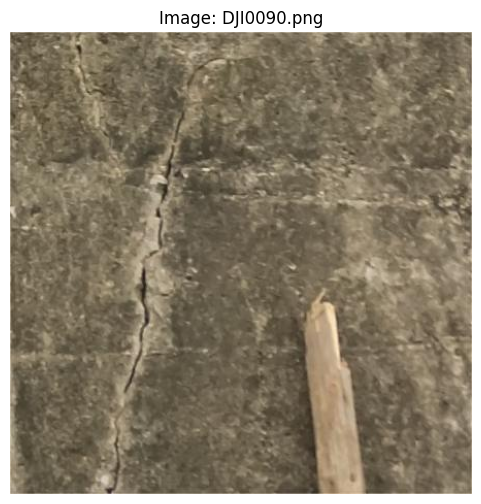

In [4]:
# =========================
# Visualize Sample Image
# =========================
def visualize_sample(image_path):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.title(f"Image: {os.path.basename(image_path)}")
    plt.axis("off")
    plt.show()

visualize_sample(img_files[0])

### Dataset Classes

In [5]:
# =================
# Dataset Classes
# =================
class CrackSegmentationDataset(Dataset):
    def __init__(self, image_files, mask_files, image_size=(448, 448)):
        self.image_files = image_files
        self.mask_files = mask_files
        self.image_size = image_size

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        # Load and process image
        img = cv2.imread(self.image_files[index])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, self.image_size) / 255.0
        img = np.transpose(img, (2, 0, 1))
        img_tensor = torch.tensor(img, dtype=torch.float32)

        # Load and process mask
        mask = cv2.imread(self.mask_files[index], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, self.image_size) / 255.0
        mask = np.expand_dims(mask, axis=0)
        mask_tensor = torch.tensor(mask, dtype=torch.float32)

        return img_tensor, mask_tensor

class AugmentedCrackDataset(CrackSegmentationDataset):
    def __init__(self, image_files, mask_files, image_size=(448, 448)):
        super().__init__(image_files, mask_files, image_size)
        self.augment = T.Compose([
            T.RandomHorizontalFlip(),
            T.RandomVerticalFlip(),
            T.RandomRotation(degrees=15),
        ])

    def __getitem__(self, index):
        img_tensor, mask_tensor = super().__getitem__(index)
        stacked = torch.cat([img_tensor, mask_tensor], dim=0)
        stacked = self.augment(stacked)
        return stacked[:3], stacked[3:]

### UNet Model Definition

Implemented in reference to Ronneberger et al. (2015).

In [6]:
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        def double_conv(in_c, out_c):
            conv = nn.Sequential(
                nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_c, out_c, kernel_size=3, padding=1),
                nn.ReLU(inplace=True),
            )
            return conv

        # Encoder (5 double convolutions)
        self.max_pool_2x2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.down_conv_1 = double_conv(3,64)
        self.down_conv_2 = double_conv(64,128)
        self.down_conv_3 = double_conv(128,256)
        self.down_conv_4 = double_conv(256,512)
        self.down_conv_5 = double_conv(512,1024)

        # Decoder
        self.up_trans_1 = nn.ConvTranspose2d(1024,512,2,2)
        self.up_conv_1 = double_conv(1024,512)

        self.up_trans_2 = nn.ConvTranspose2d(512,256,2,2)
        self.up_conv_2 = double_conv(512,256)

        self.up_trans_3 = nn.ConvTranspose2d(256,128,2,2)
        self.up_conv_3 = double_conv(256,128)

        self.up_trans_4 = nn.ConvTranspose2d(128,64,2,2)
        self.up_conv_4 = double_conv(128,64)

        # Output
        self.out = nn.Conv2d(64,1,1) # Output channels changed to 1

    def forward(self, image):
        # Encoder
        x1 = self.down_conv_1(image)
        x2 = self.max_pool_2x2(x1)
        x3 = self.down_conv_2(x2)
        x4 = self.max_pool_2x2(x3)
        x5 = self.down_conv_3(x4)
        x6 = self.max_pool_2x2(x5)
        x7 = self.down_conv_4(x6)
        x8 = self.max_pool_2x2(x7)
        x9 = self.down_conv_5(x8)

        # Decoder
        x = self.up_trans_1(x9)
        x = self.up_conv_1(torch.cat([x,x7], 1)) # Use x7 for skip connection

        x = self.up_trans_2(x)
        x = self.up_conv_2(torch.cat([x,x5], 1)) # Use x5 for skip connection

        x = self.up_trans_3(x)
        x = self.up_conv_3(torch.cat([x,x3], 1)) # Use x3 for skip connection

        x = self.up_trans_4(x)
        x = self.up_conv_4(torch.cat([x,x1], 1)) # Use x1 for skip connection

        # Output
        x = self.out(x)

        return x

In [7]:
# QUICK SANITY CHECK
image = torch.rand((1,3,512,512))
model = UNet()
print(model(image).size())

torch.Size([1, 1, 512, 512])


### DeepLabV3+ Model Definition

In [8]:
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels, rates=[1, 6, 12, 18]):
        super(ASPP, self).__init__()
        self.blocks = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_channels, out_channels, 1 if r == 1 else 3,
                          padding=0 if r == 1 else r, dilation=r, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True)
            )
            for r in rates
        ])
        self.global_avg_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        self.project = nn.Sequential(
            nn.Conv2d(out_channels * (len(rates) + 1), out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5)
        )

    def forward(self, x):
        res = [block(x) for block in self.blocks]
        global_feat = self.global_avg_pool(x)
        global_feat = F.interpolate(global_feat, size=x.shape[2:], mode='bilinear', align_corners=False)
        res.append(global_feat)
        x = torch.cat(res, dim=1)
        return self.project(x)


class DeepLabV3Plus(nn.Module):
    def __init__(self, num_classes=1, pretrained_backbone=True):
        super(DeepLabV3Plus, self).__init__()
        # resnet = resnet101(pretrained=pretrained_backbone, replace_stride_with_dilation=[False, True, True])
        resnet = resnet50(pretrained=pretrained_backbone, replace_stride_with_dilation=[False, True, True])
        # Extract specific layers for encoder
        self.layer0 = nn.Sequential(resnet.conv1, resnet.bn1, resnet.relu, resnet.maxpool)  # 1/4
        self.layer1 = resnet.layer1  # 1/4
        self.layer2 = resnet.layer2  # 1/8
        self.layer3 = resnet.layer3  # 1/16
        self.layer4 = resnet.layer4  # 1/16 (dilated)

        # ASPP module
        self.aspp = ASPP(in_channels=2048, out_channels=256)

        # Decoder: reduce low-level features to 48 channels
        self.low_level_reduce = nn.Sequential(
            nn.Conv2d(256, 48, 1, bias=False),
            nn.BatchNorm2d(48),
            nn.ReLU(inplace=True)
        )

        # Final decoder block
        self.decoder = nn.Sequential(
            nn.Conv2d(256 + 48, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, 3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, num_classes, 1)
        )

    def forward(self, x):
        input_size = x.shape[2:]

        # Encoder
        x0 = self.layer0(x)
        x1 = self.layer1(x0)  # low-level features (1/4)
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)  # high-level features (1/16)

        # ASPP
        x = self.aspp(x4)
        x = F.interpolate(x, size=x1.shape[2:], mode='bilinear', align_corners=False)

        # Decoder
        low_level = self.low_level_reduce(x1)
        x = torch.cat([x, low_level], dim=1)
        x = self.decoder(x)
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)

        return x

In [9]:
# QUICK SANITY CHECK
model = DeepLabV3Plus(num_classes=1)
x = torch.randn(2, 3, 512, 512) # Increased batch size to 2
y = model(x)
print(y.shape)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


torch.Size([2, 1, 512, 512])


### SegFormer - Transformer-based Model Definition

In [24]:
# SegFormer Model Class
class MLPDecoder(nn.Module):
    def __init__(self, dims, embed_dim=256, num_classes=1):
        super(MLPDecoder, self).__init__()
        self.linear_c = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(dim, embed_dim, 1),
                nn.BatchNorm2d(embed_dim),
                nn.ReLU(inplace=True)
            ) for dim in dims
        ])
        self.fuse = nn.Sequential(
            nn.Conv2d(embed_dim * 4, embed_dim, 1),
            nn.BatchNorm2d(embed_dim),
            nn.ReLU(inplace=True),
            nn.Conv2d(embed_dim, num_classes, 1)
        )

    def forward(self, features):
        upsampled = []
        size = features[0].shape[2:]
        for i, x in enumerate(features):
            x = self.linear_c[i](x)
            x = F.interpolate(x, size=size, mode='bilinear', align_corners=False)
            upsampled.append(x)
        x = torch.cat(upsampled, dim=1)
        return self.fuse(x)

# SegFormer with MiT Backbone
class SegFormer(nn.Module):
  def __init__(self, backbone='convnext_tiny', num_classes=1):
      super(SegFormer, self).__init__()
      self.backbone = timm.create_model(backbone, pretrained=True, features_only=True)
      dims = self.backbone.feature_info.channels()
      self.decoder = MLPDecoder(dims=dims, embed_dim=256, num_classes=num_classes)

  def forward(self, x):
      input_size = x.shape[2:]
      feats = self.backbone(x)  # List of 4 features
      x = self.decoder(feats)
      x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)
      return x

In [22]:
# QUICK SANITY CHECK
model = SegFormer(backbone='convnext_tiny', num_classes=1)
inp = torch.randn(2, 3, 448, 448)  # Example batch
out = model(inp)  # Output shape: (2, 1, 448, 448)
print(out.shape)

torch.Size([2, 1, 448, 448])


### ResNet Model Definition

Implemented in reference to He et al. (2015).

In [12]:
# --------------------
# ResNet blocks
# --------------------
def conv3x3(in_planes, out_planes, stride=1, groups=1, dilation=1):
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=dilation, bias=False, groups=groups, dilation=dilation)

def conv1x1(in_planes, out_planes, stride=1):
    return nn.Conv2d(in_planes, out_planes, kernel_size=1, stride=stride, bias=False)

class BasicBlock(nn.Module):
    expansion = 1
    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1,
                 base_width=64, dilation=1, norm_layer=nn.BatchNorm2d):
        super().__init__()
        if groups != 1 or base_width != 64:
            raise ValueError("BasicBlock only supports groups=1 and base_width=64")
        self.conv1 = conv3x3(inplanes, planes, stride, dilation=dilation)
        self.bn1 = norm_layer(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(planes, planes, dilation=dilation)
        self.bn2 = norm_layer(planes)
        self.downsample = downsample

    def forward(self, x):
        identity = x
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        if self.downsample is not None:
            identity = self.downsample(x)
        out += identity
        return self.relu(out)

class Bottleneck(nn.Module):
    expansion = 4
    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1,
                 base_width=64, dilation=1, norm_layer=nn.BatchNorm2d):
        super().__init__()
        width = int(planes * (base_width / 64.)) * groups
        self.conv1 = conv1x1(inplanes, width)
        self.bn1 = norm_layer(width)
        self.conv2 = nn.Conv2d(width, width, kernel_size=3, stride=stride,
                               padding=dilation, bias=False, groups=groups, dilation=dilation)
        self.bn2 = norm_layer(width)
        self.conv3 = conv1x1(width, planes * self.expansion)
        self.bn3 = norm_layer(planes * self.expansion)
        self.relu = nn.ReLU(inplace=True)
        self.downsample = downsample

    def forward(self, x):
        identity = x
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.relu(self.bn2(self.conv2(out)))
        out = self.bn3(self.conv3(out))
        if self.downsample is not None:
            identity = self.downsample(x)
        out += identity
        return self.relu(out)

# --------------------
# ResNet backbone (returns C2, C3, C4, C5 feature maps)
# --------------------
class _ResNetBackbone(nn.Module):
    def __init__(self, block, layers, norm_layer=nn.BatchNorm2d, output_stride=32):
        super().__init__()
        self.inplanes = 64
        self.norm_layer = norm_layer

        # stem
        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = norm_layer(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        # control output stride (dilation in late stages)
        # target strides for C2..C5 are 4, 8, 16, 32 by default
        if output_stride == 32:
            dilations = [1, 1, 1, 1]
            strides    = [1, 2, 2, 2]
        elif output_stride == 16:
            dilations = [1, 1, 1, 2]
            strides    = [1, 2, 2, 1]
        elif output_stride == 8:
            dilations = [1, 1, 2, 4]
            strides    = [1, 2, 1, 1]
        else:
            raise ValueError("output_stride must be one of {8, 16, 32}")

        self.layer1 = self._make_layer(block,  64, layers[0], stride=strides[0], dilation=dilations[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=strides[1], dilation=dilations[1])
        self.layer3 = self._make_layer(block, 256, layers[2], stride=strides[2], dilation=dilations[2])
        self.layer4 = self._make_layer(block, 512, layers[3], stride=strides[3], dilation=dilations[3])

        # init
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode="fan_out", nonlinearity="relu")
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.ones_(m.weight)
                nn.init.zeros_(m.bias)

    def _make_layer(self, block, planes, blocks, stride=1, dilation=1, groups=1, base_width=64):
        norm_layer = self.norm_layer
        downsample = None
        previous_dilation = dilation
        out_channels = planes * block.expansion

        if stride != 1 or self.inplanes != out_channels:
            downsample = nn.Sequential(
                conv1x1(self.inplanes, out_channels, stride),
                norm_layer(out_channels),
            )

        layers = [block(self.inplanes, planes, stride, downsample,
                        groups=groups, base_width=base_width, dilation=previous_dilation,
                        norm_layer=norm_layer)]
        self.inplanes = out_channels
        for _ in range(1, blocks):
            layers.append(block(self.inplanes, planes, groups=groups,
                                base_width=base_width, dilation=dilation,
                                norm_layer=norm_layer))
        return nn.Sequential(*layers)

    def forward(self, x):
        # x: [B,3,H,W]
        x = self.relu(self.bn1(self.conv1(x)))   # /2
        x = self.maxpool(x)                      # /4
        c2 = self.layer1(x)                      # stride 4
        c3 = self.layer2(c2)                     # stride 8
        c4 = self.layer3(c3)                     # stride 16 (or 8 if dilated)
        c5 = self.layer4(c4)                     # stride 32 (or 16/8 if dilated)
        return c2, c3, c4, c5

def make_resnet_backbone(depth=34, output_stride=32):
    if depth == 18:
        return _ResNetBackbone(BasicBlock, [2,2,2,2], output_stride=output_stride)
    if depth == 34:
        return _ResNetBackbone(BasicBlock, [3,4,6,3], output_stride=output_stride)
    if depth == 50:
        return _ResNetBackbone(Bottleneck, [3,4,6,3], output_stride=output_stride)
    if depth == 101:
        return _ResNetBackbone(Bottleneck, [3,4,23,3], output_stride=output_stride)
    raise ValueError("depth must be one of {18,34,50,101}")

# --------------------
# Simple FPN-like decoder
# --------------------
class FPNDecoder(nn.Module):
    def __init__(self, in_channels_list, out_channels=128, norm_layer=nn.BatchNorm2d):
        super().__init__()
        # 1x1 lateral to unify channels
        self.lateral5 = conv1x1(in_channels_list[3], out_channels)
        self.lateral4 = conv1x1(in_channels_list[2], out_channels)
        self.lateral3 = conv1x1(in_channels_list[1], out_channels)
        self.lateral2 = conv1x1(in_channels_list[0], out_channels)

        # 3x3 refinement
        self.refine5 = nn.Sequential(conv3x3(out_channels, out_channels), norm_layer(out_channels), nn.ReLU(inplace=True))
        self.refine4 = nn.Sequential(conv3x3(out_channels, out_channels), norm_layer(out_channels), nn.ReLU(inplace=True))
        self.refine3 = nn.Sequential(conv3x3(out_channels, out_channels), norm_layer(out_channels), nn.ReLU(inplace=True))
        self.refine2 = nn.Sequential(conv3x3(out_channels, out_channels), norm_layer(out_channels), nn.ReLU(inplace=True))

        # final head
        self.head = nn.Sequential(
            conv3x3(out_channels, out_channels), norm_layer(out_channels), nn.ReLU(inplace=True),
            conv1x1(out_channels, 1)
        )

    def forward(self, c2, c3, c4, c5):
        p5 = self.refine5(self.lateral5(c5))
        p4 = self.refine4(self.lateral4(c4) + F.interpolate(p5, size=c4.shape[-2:], mode="bilinear", align_corners=False))
        p3 = self.refine3(self.lateral3(c3) + F.interpolate(p4, size=c3.shape[-2:], mode="bilinear", align_corners=False))
        p2 = self.refine2(self.lateral2(c2) + F.interpolate(p3, size=c2.shape[-2:], mode="bilinear", align_corners=False))

        logits = self.head(p2)  # stride 4 resolution
        return logits

# --------------------
# Full model: ResNet encoder + FPN decoder
# --------------------
class ResNetSegmentation(nn.Module):
    """
    ResNet backbone with FPN-like decoder producing a 1-channel sigmoid mask.
    Args:
        depth: 18, 34, 50, or 101
        output_stride: 32, 16, or 8   (use 16/8 to keep more detail via dilation)
    """
    def __init__(self, depth=34, output_stride=16):
        super().__init__()
        self.backbone = make_resnet_backbone(depth=depth, output_stride=output_stride)
        # figure out channel dims given block expansion
        if depth in (18, 34):
            ch = [64, 128, 256, 512]
        else:
            ch = [256, 512, 1024, 2048]
        self.decoder = FPNDecoder(in_channels_list=ch, out_channels=128)

    def forward(self, x):
        B, C, H, W = x.shape
        c2, c3, c4, c5 = self.backbone(x)
        logits = self.decoder(c2, c3, c4, c5)
        # upsample to input size
        logits = F.interpolate(logits, size=(H, W), mode="bilinear", align_corners=False)
        return logits

In [13]:
# QUICK SANITY CHECK
model = ResNetSegmentation(depth=34, output_stride=16)
x = torch.randn(1, 3, 512, 512)
y = model(x)
print(y.shape)  # expected: [1, 1, 448, 448]

torch.Size([1, 1, 512, 512])


### Loss and Optimizer

In [14]:
class BCEDiceLoss(nn.Module):
    def __init__(self, bce_weight=0.5, dice_weight=0.5, eps=1e-7):
        super().__init__()
        self.bce = nn.BCEWithLogitsLoss()
        self.bce_w = bce_weight
        self.dice_w = dice_weight
        self.eps = eps

    def forward(self, pred, target):
        # pred: logits [B,1,H,W] ; target: [B,1,H,W] in {0,1} (or [0,1])
        bce_loss = self.bce(pred, target)

        # Dice on probabilities
        probs = torch.sigmoid(pred)
        # compute per-sample dice then average
        dims = (1, 2, 3)  # sum over C,H,W
        intersection = (probs * target).sum(dim=dims)
        denom = probs.sum(dim=dims) + target.sum(dim=dims)
        dice = (2.0 * intersection + self.eps) / (denom + self.eps)
        dice_loss = 1.0 - dice.mean()

        return self.bce_w * bce_loss + self.dice_w * dice_loss

In [15]:
# ====================================
# Training and Evaluation Utilities
# ====================================
def train_model(model, dataloader, optimizer, criterion, device):
    model.train()
    running_loss = 0.0
    for imgs, masks in dataloader:
        imgs, masks = imgs.to(device), masks.to(device)
        optimizer.zero_grad()
        preds = model(imgs)
        loss = criterion(preds, masks)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
    return running_loss / len(dataloader)

def iou_score(pred, target, threshold=0.5):
    pred = (pred > threshold).float()
    target = (target > threshold).float()
    intersection = (pred * target).sum()
    union = pred.sum() + target.sum() - intersection + 1e-7
    return (intersection / union).item()

def dice_coeff(pred, target, threshold=0.5):
    pred = (pred > threshold).float()
    target = (target > threshold).float()
    intersection = (pred * target).sum()
    return (2. * intersection / (pred.sum() + target.sum() + 1e-7)).item()

def evaluate_model(model, dataloader, criterion, device):
    model.eval()
    total_loss = 0.0
    total_iou = 0.0
    total_dice = 0.0
    count = 0

    with torch.no_grad():
        for imgs, masks in dataloader:
            imgs, masks = imgs.to(device), masks.to(device)
            preds = model(imgs)
            total_loss += criterion(preds, masks).item()
            for p, m in zip(preds, masks):
                total_iou += iou_score(p, m)
                total_dice += dice_coeff(p, m)
                count += 1

    return total_loss / len(dataloader), total_iou / count, total_dice / count

In [25]:
# ==================
# Training Pipeline
# ==================
def run_training_pipeline(model_name, image_files, mask_files):

    # Log for Tensorboard and later pre-processing
    # Save logs and TensorBoard data to a writable location, e.g., Google Drive
    log_dir = "/content/drive/MyDrive/crack_detection/runs"
    log_file_path = os.path.join(log_dir, f"training_log_{model_name}.txt")
    os.makedirs(log_dir, exist_ok=True) # Create directory if it doesn't exist

    log_file = open(log_file_path, "w")

    writer = SummaryWriter(log_dir=os.path.join(log_dir, f"crack_segmentation_{model_name}"))
    dataset = AugmentedCrackDataset(image_files, mask_files)

    # Train-test Split
    train_size = int(0.8 * len(dataset))
    test_size = len(dataset) - train_size
    train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

    train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
    test_loader = DataLoader(test_dataset, batch_size=4)

    # Get device
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Choose between models
    if model_name == "UNet":
      model = UNet().to(device)
    elif model_name == "ResNet":
      model = ResNetSegmentation(depth=34, output_stride=16).to(device)
    elif model_name == "DeepLabV3Plus":
      model = DeepLabV3Plus(num_classes=1).to(device)
    elif model_name == "SegFormer":
      model = SegFormer(num_classes=1).to(device)
    else:
        raise ValueError(f"Unknown model name: {model_name}")


    # Optimizer
    optimizer = optim.Adam(model.parameters(), lr=1e-4)

    # Loss Criteria
    criterion = BCEDiceLoss()

    # Select a sample image and mask for visualization during training
    vis_img, vis_mask = test_dataset[0]
    vis_img = vis_img.to(device)

    epochs = 100
    for epoch in range(epochs):
        train_loss = train_model(model, train_loader, optimizer, criterion, device)
        test_loss, test_iou, test_dice = evaluate_model(model, test_loader, criterion, device)

        log_msg = (f"Epoch {epoch+1}/{epochs} | "
           f"Train: {train_loss:.4f} | "
           f"Test: {test_loss:.4f} | "
           f"IoU: {test_iou:.4f} | "
           f"Dice: {test_dice:.4f}")

        print(log_msg)
        log_file.write(log_msg + "\n")

        writer.add_scalar("Loss/Train", train_loss, epoch)
        writer.add_scalar("Loss/Test", test_loss, epoch)
        writer.add_scalar("Metric/IoU", test_iou, epoch)
        writer.add_scalar("Metric/Dice", test_dice, epoch)

        model.eval()
        with torch.no_grad():
            # Add batch dimension for model input
            pred = model(vis_img.unsqueeze(0))[0].cpu()
        writer.add_image("Input", vis_img.cpu(), epoch)
        writer.add_image("Prediction", pred, epoch)
        writer.add_image("GroundTruth", vis_mask, epoch)
        writer.flush()


    writer.close()
    log_file.close()
    return model

In [17]:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/crack_detection/runs

<IPython.core.display.Javascript object>

### Model Training

In [ ]:
model_name = "UNet"
model = run_training_pipeline(model_name, img_files, mask_files)
# Save the model to use later
save_path = os.path.join("/content/drive/MyDrive/crack_detection", f"crack_segmentation_model_{model_name}.pth")
torch.save(model.state_dict(), save_path)

In [15]:
model_name = "DeepLabV3Plus"
model = run_training_pipeline(model_name, img_files, mask_files)
# Save the model to use later
save_path = os.path.join("/content/drive/MyDrive/crack_detection", f"crack_segmentation_model_{model_name}.pth")
torch.save(model.state_dict(), save_path)

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch 1/100 | Train: 0.6078 | Test: 0.5399 | IoU: 0.2729 | Dice: 0.4134
Epoch 2/100 | Train: 0.4880 | Test: 0.4632 | IoU: 0.3713 | Dice: 0.5182
Epoch 3/100 | Train: 0.4397 | Test: 0.4198 | IoU: 0.4610 | Dice: 0.6186
Epoch 4/100 | Train: 0.3903 | Test: 0.3625 | IoU: 0.4743 | Dice: 0.6309
Epoch 5/100 | Train: 0.3435 | Test: 0.3406 | IoU: 0.4628 | Dice: 0.6198
Epoch 6/100 | Train: 0.3067 | Test: 0.2946 | IoU: 0.5264 | Dice: 0.6801
Epoch 7/100 | Train: 0.2701 | Test: 0.2566 | IoU: 0.5283 | Dice: 0.6772
Epoch 8/100 | Train: 0.2439 | Test: 0.2290 | IoU: 0.5519 | Dice: 0.7029
Epoch 9/100 | Train: 0.2146 | Test: 0.2025 | IoU: 0.5776 | Dice: 0.7236
Epoch 10/100 | Train: 0.1991 | Test: 0.2079 | IoU: 0.5404 | Dice: 0.6758
Epoch 11/100 | Train: 0.1924 | Test: 0.1821 | IoU: 0.5919 | Dice: 0.7340
Epoch 12/100 | Train: 0.1712 | Test: 0.2010 | IoU: 0.5419 | Dice: 0.6858
Epoch 13/100 | Train: 0.1660 | Test: 0.1794 | IoU: 0.5629 | Dice: 0.7088
Epoch 14/100 | Train: 0.1714 | Test: 0.1732 | IoU: 0.5815 | 

In [26]:
model_name = "SegFormer"
model = run_training_pipeline(model_name, img_files, mask_files)
# Save the model to use later
save_path = os.path.join("/content/drive/MyDrive/crack_detection", f"crack_segmentation_model_{model_name}.pth")
torch.save(model.state_dict(), save_path)

Epoch 1/100 | Train: 0.5917 | Test: 0.5287 | IoU: 0.1579 | Dice: 0.2373
Epoch 2/100 | Train: 0.4931 | Test: 0.5862 | IoU: 0.2739 | Dice: 0.4109
Epoch 3/100 | Train: 0.4418 | Test: 0.4695 | IoU: 0.3404 | Dice: 0.4922
Epoch 4/100 | Train: 0.3909 | Test: 0.3695 | IoU: 0.4310 | Dice: 0.5760
Epoch 5/100 | Train: 0.3561 | Test: 0.3764 | IoU: 0.4356 | Dice: 0.5804
Epoch 6/100 | Train: 0.3104 | Test: 0.3155 | IoU: 0.4576 | Dice: 0.6113
Epoch 7/100 | Train: 0.2754 | Test: 0.2806 | IoU: 0.4945 | Dice: 0.6446
Epoch 8/100 | Train: 0.2497 | Test: 0.2656 | IoU: 0.5206 | Dice: 0.6714
Epoch 9/100 | Train: 0.2164 | Test: 0.2219 | IoU: 0.5421 | Dice: 0.6921
Epoch 10/100 | Train: 0.2024 | Test: 0.2212 | IoU: 0.5296 | Dice: 0.6675
Epoch 11/100 | Train: 0.1908 | Test: 0.2222 | IoU: 0.5096 | Dice: 0.6531
Epoch 12/100 | Train: 0.1818 | Test: 0.1932 | IoU: 0.5478 | Dice: 0.6960
Epoch 13/100 | Train: 0.1665 | Test: 0.2031 | IoU: 0.5170 | Dice: 0.6534
Epoch 14/100 | Train: 0.1628 | Test: 0.1833 | IoU: 0.5611 | 

In [18]:
model_name = "ResNet"
model = run_training_pipeline(model_name, img_files, mask_files)
# Save the model to use later
save_path = os.path.join("/content/drive/MyDrive/crack_detection", f"crack_segmentation_model_{model_name}.pth") # Changed save path to use model_name
torch.save(model.state_dict(), save_path)

Epoch 1/100 | Train: 0.6935 | Test: 0.6261 | IoU: 0.0099 | Dice: 0.0176
Epoch 2/100 | Train: 0.5958 | Test: 0.6078 | IoU: 0.2021 | Dice: 0.3038
Epoch 3/100 | Train: 0.5632 | Test: 0.5443 | IoU: 0.2191 | Dice: 0.3013
Epoch 4/100 | Train: 0.5390 | Test: 0.5305 | IoU: 0.2711 | Dice: 0.3819
Epoch 5/100 | Train: 0.5143 | Test: 0.5114 | IoU: 0.3085 | Dice: 0.4383
Epoch 6/100 | Train: 0.4927 | Test: 0.4897 | IoU: 0.3155 | Dice: 0.4450
Epoch 7/100 | Train: 0.4709 | Test: 0.5064 | IoU: 0.2219 | Dice: 0.3333
Epoch 8/100 | Train: 0.4503 | Test: 0.4412 | IoU: 0.3586 | Dice: 0.4850
Epoch 9/100 | Train: 0.4264 | Test: 0.4266 | IoU: 0.3440 | Dice: 0.4662
Epoch 10/100 | Train: 0.4039 | Test: 0.4007 | IoU: 0.3753 | Dice: 0.4987
Epoch 11/100 | Train: 0.3784 | Test: 0.3789 | IoU: 0.3826 | Dice: 0.5112
Epoch 12/100 | Train: 0.3552 | Test: 0.3754 | IoU: 0.3936 | Dice: 0.5194
Epoch 13/100 | Train: 0.3379 | Test: 0.3533 | IoU: 0.4124 | Dice: 0.5483
Epoch 14/100 | Train: 0.3125 | Test: 0.3248 | IoU: 0.4203 | 

In [35]:
# Load and run prediction
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def get_model(model_name):
  save_path = os.path.join("/content/drive/MyDrive/crack_detection", f"crack_segmentation_model_{model_name}.pth")
  if model_name == "UNet":
    model = UNet().to(device)
  elif model_name == "ResNet":
    model = ResNetSegmentation(depth=34, output_stride=16).to(device)
  elif model_name == "DeepLabV3Plus":
    model = DeepLabV3Plus(num_classes=1).to(device)
  elif model_name == "SegFormer":
    model = SegFormer(num_classes=1).to(device)
  model.load_state_dict(torch.load(save_path))
  return model

In [46]:
# ============================
# Visualization and Inference
# ============================
def visualize_predictions(model_name, model, dataset, device, indices):
    model.to(device).eval()

    fig, axs = plt.subplots(len(indices), 3, figsize=(10, 3.5 * len(indices)))
    for row, idx in enumerate(indices):
        img, mask = dataset[idx]
        img = img.to(device)

        with torch.no_grad():
            pred = model(img.unsqueeze(0))[0].cpu().squeeze()

        # Plot each of the 3 columns: input, ground truth, prediction
        axs[row, 0].imshow(np.transpose(img.cpu().numpy(), (1, 2, 0)))
        axs[row, 0].set_title(f"Input Image {os.path.basename(img_files[idx])}")

        axs[row, 1].imshow(mask.squeeze().numpy(), cmap='gray')
        axs[row, 1].set_title("Ground Truth")

        axs[row, 2].imshow((pred > 0.5).numpy(), cmap='gray')
        axs[row, 2].set_title(f"Predicted Mask ({model_name})")

        for col in range(3):
            axs[row, col].axis("off")

    plt.tight_layout()
    path = os.path.join("/content/drive/MyDrive/crack_detection", f"{model_name}_predictions.png")
    plt.savefig(path)
    plt.show()

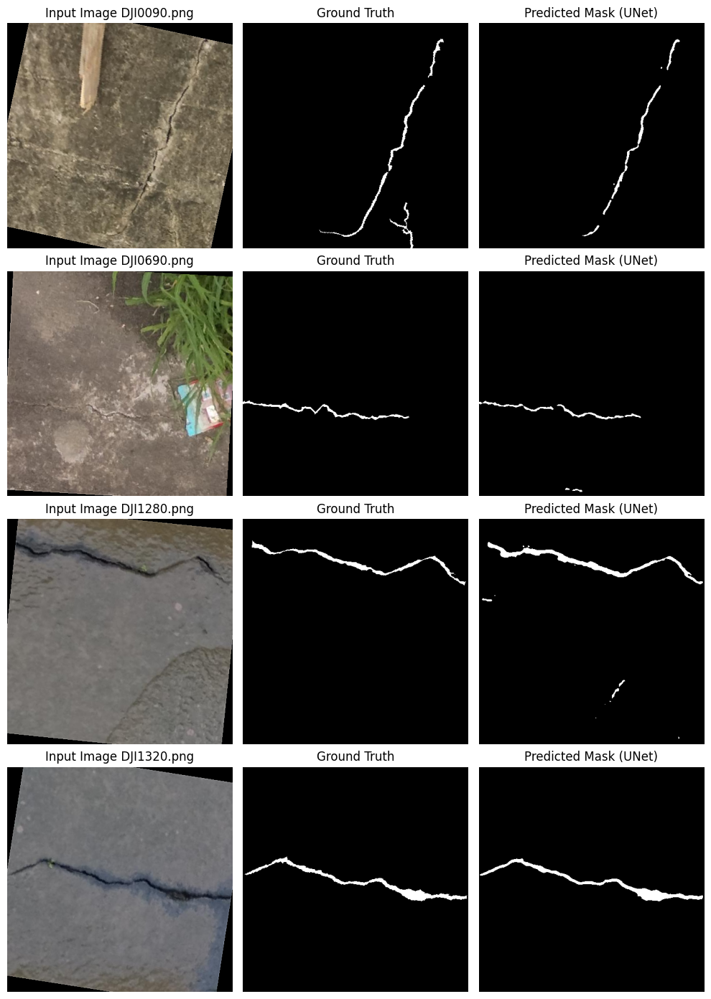

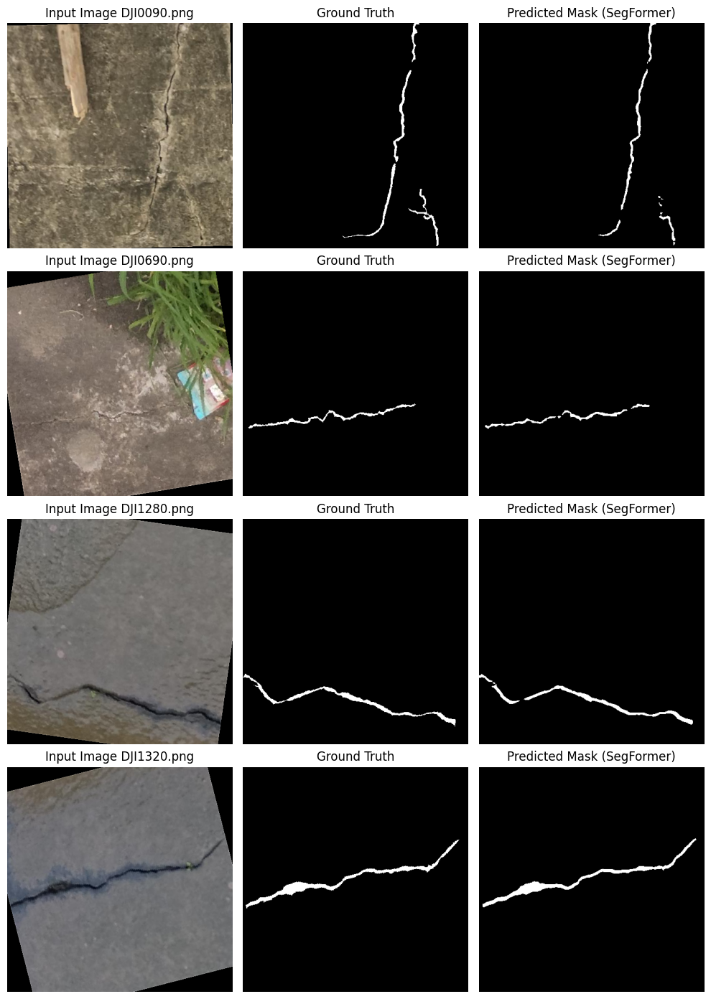

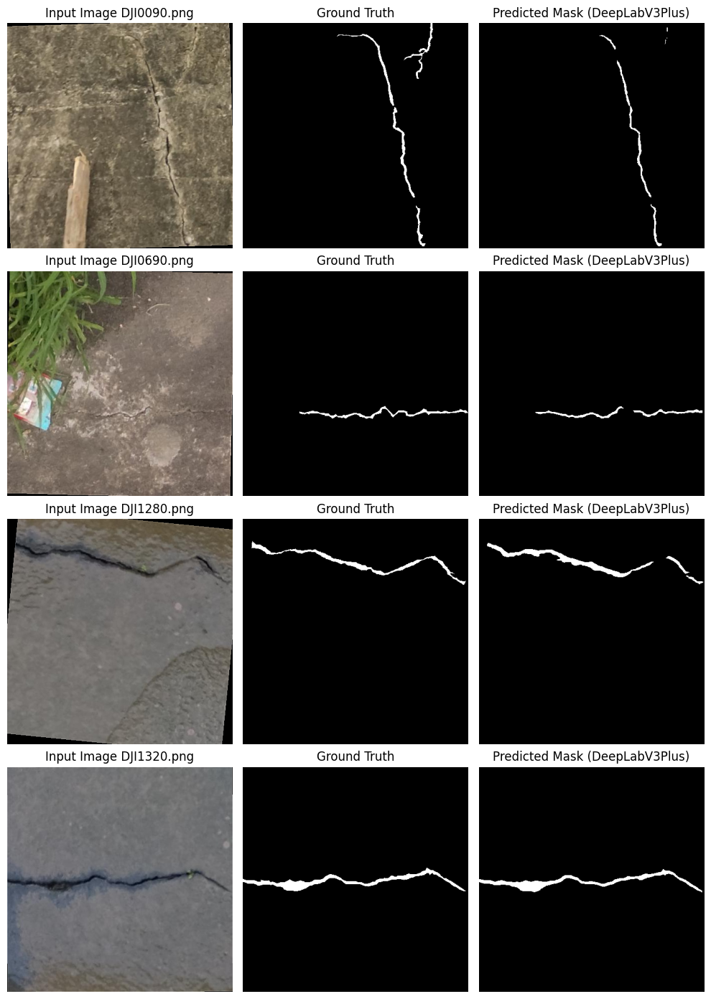

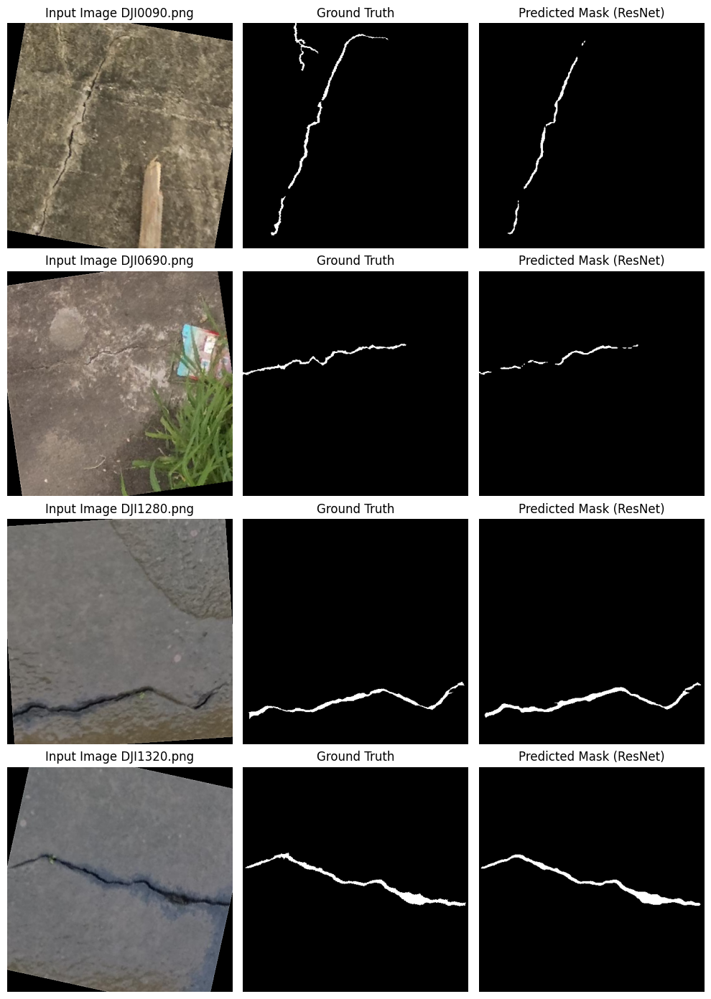

In [47]:
dataset = AugmentedCrackDataset(img_files, mask_files)
model_names = ['UNet', 'SegFormer', 'DeepLabV3Plus', 'ResNet']
image_indices = [0,1,2,3]
for i, model_name in enumerate(model_names):
    model = get_model(model_name)
    visualize_predictions(model_name, model, dataset, device, indices=image_indices)

In [63]:
import os
import matplotlib.pyplot as plt

# Use Times New Roman globally
plt.rcParams['font.family'] = 'DejaVu Serif'

log_dir = "/content/drive/MyDrive/crack_detection/runs"
output_dir = "/content/drive/MyDrive/crack_detection/plots"
os.makedirs(output_dir, exist_ok=True)

def load_all_metrics(model_name):
    path = os.path.join(log_dir, f"training_log_{model_name}.txt")
    train_losses, test_losses, ious, dices = [], [], [], []

    with open(path, "r") as f:
        for line in f:
            try:
                parts = line.strip().split("|")
                train_losses.append(float(parts[1].strip().split(":")[1]))
                test_losses.append(float(parts[2].strip().split(":")[1]))
                ious.append(float(parts[3].strip().split(":")[1]))
                dices.append(float(parts[4].strip().split(":")[1]))
            except (IndexError, ValueError):
                print(f"Skipping malformed line in {model_name}: {line.strip()}")

    return {
        "Train Loss": train_losses,
        "Test Loss": test_losses,
        "IoU": ious,
        "Dice": dices
    }

def plot_and_save_metric(metric_name, data_dict):
    plt.figure(figsize=(10, 7))

    for model_name, values in data_dict.items():
        epochs = range(1, len(values) + 1)
        plt.plot(epochs, values, label=model_name, linewidth=2, marker='o', markersize=4)

    plt.title(f"{metric_name} Over Epochs", fontsize=20, weight='bold', pad=20)
    plt.xlabel("Epoch", fontsize=16)
    plt.ylabel(metric_name, fontsize=16)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.legend(fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()

    # Save the plot
    filename = f"{metric_name.lower().replace(' ', '_')}_comparison.png"
    path = os.path.join(output_dir, filename)
    plt.savefig(path, dpi=200, bbox_inches='tight')
    plt.close()
    print(f"Saved: {path}")


def plot_comparative_metrics(model_names):
    # Collect all data
    all_metrics = {
        "Train Loss": {},
        "Test Loss": {},
        "IoU": {},
        "Dice": {}
    }

    for model_name in model_names:
        metrics = load_all_metrics(model_name)
        for key in all_metrics:
            all_metrics[key][model_name] = metrics[key]

    # Plot and save each metric separately
    for metric_name, data_dict in all_metrics.items():
        plot_and_save_metric(metric_name, data_dict)


# Usage
model_names = ['UNet', 'SegFormer', 'DeepLabV3Plus', 'ResNet']
plot_comparative_metrics(model_names)

Saved: /content/drive/MyDrive/crack_detection/plots/train_loss_comparison.png
Saved: /content/drive/MyDrive/crack_detection/plots/test_loss_comparison.png
Saved: /content/drive/MyDrive/crack_detection/plots/iou_comparison.png
Saved: /content/drive/MyDrive/crack_detection/plots/dice_comparison.png
